# Soft Body Collisions with torque

Soft body collisions work by when an object collides with another object both objects apply an equal and opposite force perpendicular to the surface of each object. This force does not prevent the two objects surfaces from overlapping. We can think of each object as a spring so $F = -k x$. This means closer the to objects are together the stronger the force that pulls them apart. We can control the stiffness of the "softbodies" using the spring constant $k$. Using this we can create simulate a bouncing ball if we know it's spring coefficient. 

Now that we have a 2D bouncing ball something does seem right to me. The ball just glides on top of the surfaces as if there is no friction. We cannot just add the normal friction force equation $F = μN$ becuase our object is a ball and has the ability to rotate. This extra degree of freedom makes this a more difficult problem to solve. Using the laws of conservation of energy, moment of inertia, and assuming that no slipping occurs we were able to create a 2D bouncing ball that rolls. 

Overall this project is not about perfectly simulating reality but rather to help understand the basic physics that I have been learning more deeply and in a fun way. This project was a fun way to actually use the equation that I have learned my first semester in college. 

In [237]:
from numpy import array,pi,cos,sin,radians,transpose,pi,linspace
from numpy.linalg import norm
from matplotlib import pyplot as plt
%matplotlib inline
from matplotlib import pyplot as plt, style
#Restart matplotlib
plt.close()
style.use('seaborn-v0_8')

# Function to calculate the projection of a point on a line
def Projection(c,L,P):
    L = L - c
    P = P - c
    L_P = L[0] * P[0] + L[1] * P[1]
    L_L = L[0]**2 + L[1]**2
    Ratio = L_P/L_L
    if Ratio >= 1:
        return 10000
        #return L + c
    if Ratio <= 0:
        return 10000
        #return c
    else:
        return Ratio*L + c

# Line class to represent a line in 2D space
class Line():
    def __init__(self,p1,p2,ID=1):
        # Initialize the line with its two end points (p1 and p2) and an optional ID
        self.p1 = array(p1)
        self.p2 = array(p2)
        self.id = ID
    
    # Method to calculate the projection of a point on the line
    def info(self,that):
        self.Proj = Projection(self.p1,self.p2,that.p[-1])
        self.UnitVector = (that.p[-1] - self.Proj)/norm(that.p[-1] - self.Proj)
        return Projection(self.p1,self.p2,that.p[-1])
    
    # Method to draw the line on a plot
    def draw(self):
        T = array([self.p1,self.p2]).T
        plt.plot(T[0],T[1],"-")

# Ball class to represent a ball in 2D space
class ball():
    def __init__(self,p,lines,v=[0.0,0.0],r = 1,w = 0,m = 10,dt = 0.01,Length_T=20):
        # Initialize the ball with its initial position (p), list of lines (lines), initial velocity (v), radius (r), initial angular velocity (w), mass (m), and time step (dt)
        self.lines = lines
        self.p = [array(p)]
        self.v = [array(v)]
        self.r = r
        self.w = [w]
        self.m = m
        self.t = [0.0]
        self.θ = [0.0]
        self.dt = dt
        self.μk = 0.2
        self.μs = 0.6
        self.I = 1/2 * self.m * self.r**2
        self.N = 0
        self.Length_T = Length_T
    
    # Method to calculate the acceleration of the ball
    def acceleration(self):
        netF = self.normalF() #+ self.dragF()#*self.scale

        # Calculate the net force acting on the ball (currently only includes normal forces)
        netF[1] += -9.8*self.m
        # Return the acceleration of the ball (divided by mass)
        return netF/self.m
    
    # Method to calculate the drag force acting on the ball
    def dragF(self):
        𝜌 = 1.29
        𝐶 = 0.5  
        𝐴 = pi * (self.r)**2
        # Calculate the x and y components of the drag force
        Fx = 1/2 * 𝐶 *𝜌 * 𝐴 * norm(self.v[-1]) * -self.v[-1][0]
        Fy = 1/2 * 𝐶 *𝜌 * 𝐴 * norm(self.v[-1]) * -self.v[-1][1]
        # Return the drag force as a vector
        return array([Fx,Fy])
    
    # Method to calculate the normal forces acting on the ball
    def normalF(self):
        # Initialize the net normal force as a zero vector
        fN = array([0.0,0.0])
        # Iterate through the lines
        for line in self.lines:
            # Calculate the projection of the ball's position on the line and the unit vector perpendicular to the line
            line.info(self)
            # Calculate the distance between the ball and the line
            dist = norm(line.Proj-self.p[-1])
            # Spring constant
            k = 50000
            # If the distance is less than the radius of the ball, apply a normal force
            if dist < self.r:
                #self.v[-1] *= 0.9
                self.N = k*(self.r-dist)
                fN += self.N * line.UnitVector
        # Return the net normal force
        return fN     
    
    # Method to update the ball's motion
    def motion(self):
        # Run the motion update loop for a maximum of "Length_T" seconds
        while self.t[-1] < self.Length_T:
            # Calculate the acceleration of the ball
            a = self.acceleration()
            # Calculate the torque acting on the ball
            self.torqueA()
            # Update the angular velocity of the ball
            self.w.append(self.w[-1])
            # Update the velocity of the ball
            self.v.append(self.v[-1]+a*self.dt)
            # Update the orientation of the ball
            self.θ.append(self.θ[-1] + self.w[-1]*self.dt)
            # Update the position of the ball
            self.p.append(self.p[-1] + self.v[-1]*self.dt)
            # Update the time
            self.t.append(self.t[-1] + self.dt)
            
    # Method to calculate the torque acting on the ball
    def torqueA(self):
        for line in self.lines:
            line.info(self)
            dist = norm(line.Proj-self.p[-1])
            if dist <= self.r:
                D = line.Proj - self.p[-1]
                L = array([D[1],-D[0]])
                # Calculate the velocity of the ball in the direction of the line
                V_direction_line = sum(L*self.v[-1])/norm(L)
                frictionFk = self.N * self.μk
                frictionFs = self.N * self.μs
                # Calculates the change in angular velocity and tranlational velocity following the laws of conservation of energy
                if abs(V_direction_line) > 0:
                    Wf = ((self.I*self.w[-1]**2 + self.m* V_direction_line**2) / (3 * self.I))**0.5  * V_direction_line/abs(V_direction_line) 
                elif abs(self.w[-1]) > 0:
                    Wf = ((self.I*self.w[-1]**2) / (3 * self.I))**0.5  * self.w[-1]/abs(self.w[-1])
                else:
                    Wf = 0
                Vf = self.r * Wf
                # Update the angular velocity of the ball and the velocity
                self.w[-1] = Wf
                self.v[-1] += (Vf-V_direction_line) * L/norm(L)  
    
    # Method to draw the ball on a plot
    def draw(self):
        %matplotlib inline
        P = array(self.p).T
        # Draw a line to show the motion of the ball on the plot
        plt.plot(P[0],P[1],"-",ms=1)
        # Draw a line to show the rotation of the ball on the plot
        plt.plot(P[0] + cos(-1 * array(self.θ)) * self.r,P[1]+ sin(-1 * array(self.θ)) * self.r,"-",ms=1)
        # Set the limits of the plot
        plt.xlim(-10,30)
        plt.ylim(-10,10)
        plt.show()
    def ANIMATE(self):
        %matplotlib widget
        fig, ax = plt.subplots()
        line1, = ax.plot([], [])
        line2, = ax.plot([], [], ".k")
        line3, = ax.plot([], [], ".")
        ax.set_aspect('equal')
        A = linspace(0,2*pi,20)
        A2 = linspace(0,2*pi,3)
        plt.xlim(-10,30)
        plt.ylim(-10,10)
        steps = 5
        for line in self.lines:
            line.draw()
        def animateWave(frame):
            t = frame*self.dt*steps
            p = self.p[frame*steps]
            θ = self.θ[frame*steps]
            line1.set_data(p[0] + self.r*sin(A),p[1]+ self.r*cos(A))
            line2.set_data(p[0] + self.r*sin(-θ +A2),p[1]+ self.r*cos(-θ +  A2))
            line3.set_data([p[0]]*2,[p[1]]*2) 
            ax.set_title(f"Time: {t:.2f} s")
            return line1,line2,line3
        anim = FuncAnimation(fig, animateWave, frames=len(self.p)//steps, interval=20)
        return HTML(anim.to_jshtml())
        
#plt.figure(figsize = (20,10))

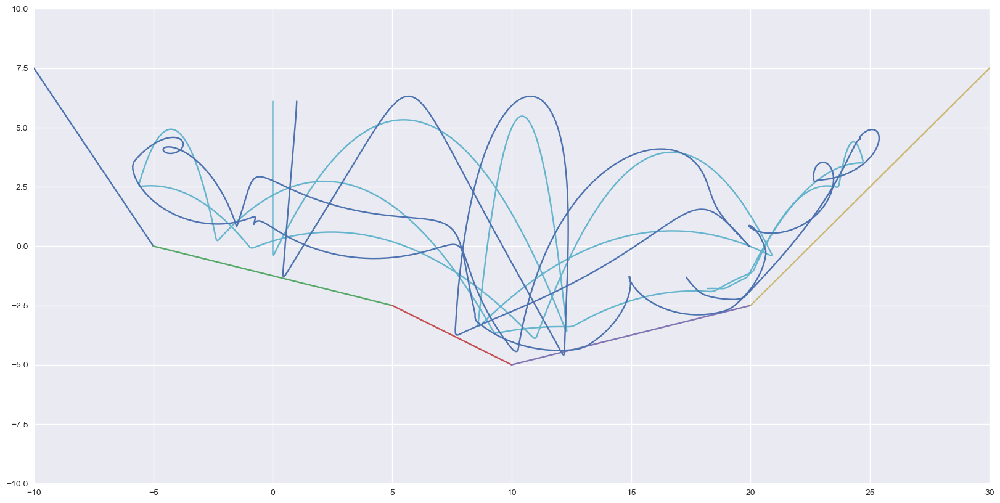

In [239]:
#Restart matplotlib
plt.close()
plt.figure(figsize = (20,10))
Points = []
Points = [[-10.0,7.5],[-5.0,0.0],[5.0,-2.5],[10.0,-5.0],[20.0,-2.5],[30.0,7.5]]
#Points = [[-10.0,7.5],[-5.0,-2.5],[10.0,-2.5],[20.0,-2.5],[30.0,7.5]]
lines = []
for i,Point in enumerate(Points[1:]):
    lines.append(Line(Points[i],Point,ID = i))
for line in lines:
    line.draw()
BB = ball([15.0,7.5],lines)      
BB = ball([0.0,6.1],lines,dt = 0.01, w = 1)   
BB.motion()
BB.draw()

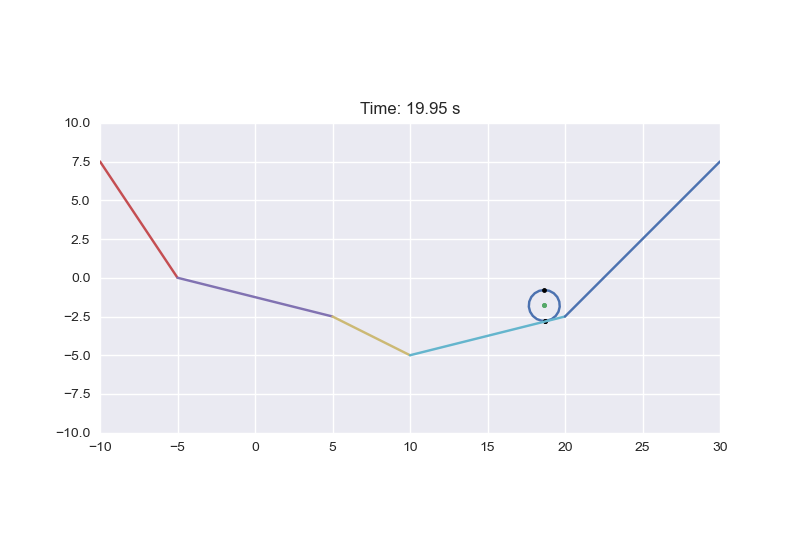

In [241]:
BB.ANIMATE()


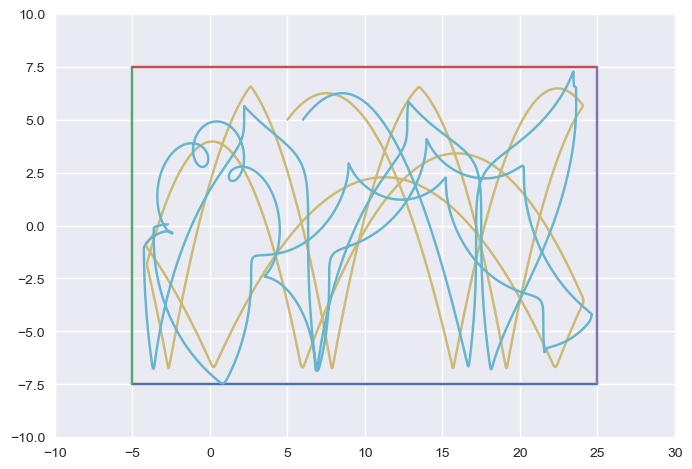

In [242]:
#Restart matplotlib
plt.close()
# Create a list of lines
lines = [Line([-5,-7.5],[25,-7.5]),Line([-5,-7.5],[-5,7.5]),Line([-5,7.5],[25,7.5]),Line([25,7.5],[25,-7.5])]
for line in lines:
    line.draw()
# Create a ball at position (5,5) with the given lines and initial velocity (5,5)
bouncing_ball = ball([5,5],lines,v=[5,5])
# Update the ball's motion
bouncing_ball.motion()
bouncing_ball.draw()

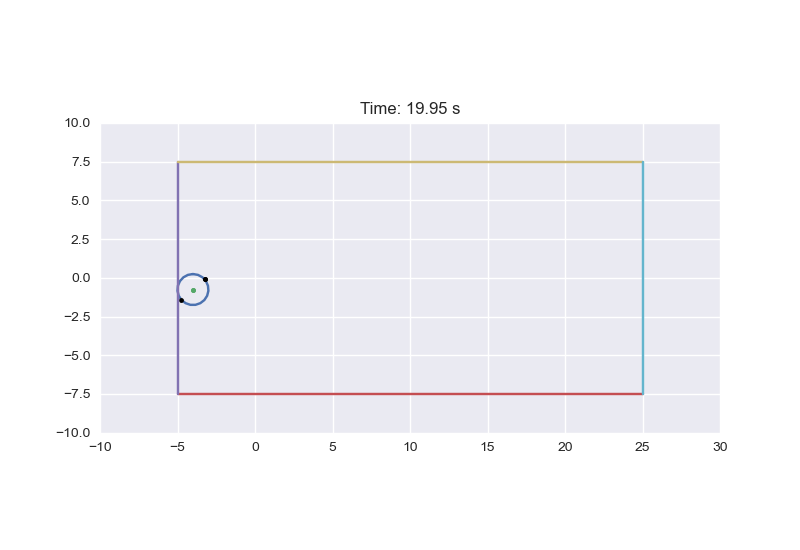

In [243]:
# Animate the ball's motion
bouncing_ball.ANIMATE()

In [191]:
#Restart matplotlib
plt.close()